<a href="https://colab.research.google.com/github/AllanKamimura/AI/blob/master/satelite%20mask/Satelite_image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Automatic detection in satellite images with Convolutional Neural Network and TensorFlow 2.x

3 datasets with different detection goals:
1.   Satellite images with High Latitude Dust (87 images) \
\> https://github.com/nasa/spaceapps-phenomena_detection/tree/dev/data/labeled
2.   Satellite images with Water Bodies (2411 images) \
\> https://www.kaggle.com/franciscoescobar/satellite-images-of-water-bodies \
\> I cleaned some of the images with a weird crop and full black mask 
3.   38-Cloud: Cloud Segmentation in Satellite Images (1577 images)\
\> https://www.kaggle.com/sorour/38cloud-cloud-segmentation-in-satellite-images \
\> I did a lot of clean up in this dataset, the original training set have 8400 images .TIF (Red + Green + Blue + IR + Masks) and 6.1GB, but mostly with full white or full black images

two models:
1.   *NN version 1:* 10 convolutional layers in Sequential 
2.   *NN version 2:* U-net architeture with 3 MaxPooling layers








# Init
Import python libraries and define variables

In [ ]:
#prepare data
import os
import random
import zipfile
from google_drive_downloader import GoogleDriveDownloader

#important libraries
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator

#upload test images
from google.colab import files

#create saves/loads
import datetime
import ipywidgets 
from keras.utils.vis_utils import plot_model

sequential_model = "a"
unet_model = "a"

**Create folder tree:**
```
── train
    ├── image
    │   └──  img
    │        ├── Satelite_image1.tiff
    │        ├── Satelite_image2.tiff
    │        └──  ...
    └── mask
        └──  img
             ├── Mask1_bitmap.png
             ├── Mask2_bitmap.png
             └──  ...
```

In [ ]:
def create_folders(): 
    try: #if directory doesn't exists, make directory 
        os.mkdir(main_path)
    except Exception as e:
        print(e)

    try: #if directory doesn't exists, make directory 
        os.mkdir(train_path)
        os.mkdir(val_path)
    except Exception as e:
        print(e)

    try: #if directory doesn't exists, make directory 
        os.mkdir(save_path)
    except Exception as e:
        print(e)

    try: #if directory doesn't exists, make directory
        os.mkdir(train_path + "/image")
        os.mkdir(train_path + "/image/img")

        os.mkdir(train_path + "/mask")
        os.mkdir(train_path + "/mask/img")

        os.mkdir(val_path + "/image")
        os.mkdir(val_path + "/image/img")

        os.mkdir(val_path + "/mask")
        os.mkdir(val_path + "/mask/img")
    except Exception as e:
        print(e)
    return "folders ok"            

In [ ]:
def split_data_dust(val_split): 
    global val_images #global variable, I'm going to use this to show the images later
    dust_path = download_path + "/dust"
    images = [arquivo for arquivo in os.listdir(dust_path) if ".tiff" in arquivo] #image format .tiff, mask format .bitmap
    k = int(len(images)*(val_split/100)) #sample length
    val_images = random.sample(images, k = k) #list with val_images file names

    for image in images:
        if image in val_images: #separate val images
            os.rename(os.path.join(dust_path, image), val_path + "/image/img/" + image) #change the absolute path of the image
            name, _ = image.split(".") #get filename without extension
            image = name + "_bitmap.png" #mask, same filename but with .bitmap extension
            os.rename(os.path.join(dust_path, image), val_path + "/mask/img/" + image)
        else: #separate train images
            os.rename(os.path.join(dust_path, image), train_path + "/image/img/" + image) #change the absolute path of the image
            name, _ = image.split(".") #get filename without extension
            image = name + "_bitmap.png" #mask, same filename but with _bitmap.png extension
            os.rename(os.path.join(dust_path, image), train_path + "/mask/img/" + image)
    try:
        saves = [save for save in os.listdir(download_path + "/save")]
        for save in saves:
            os.rename(download_path + "/save/" + save, save_path + "/" + save)
    except Exception as e:
        print(e)

    print("copied {} training images and {} validation images".format(len(images) - len(val_images),len(val_images)))

In [ ]:
def split_data_water(val_split):
    global val_images #global variable, I'm going to use this to show the images later
    water_path = download_path + "/Water Bodies Dataset"
    images = [arquivo for arquivo in os.listdir(water_path + "/Images")] 
    k = int(len(images)*(val_split/100)) #sample length
    val_images = random.sample(images, k = k) #list with val_images file names

    for image in images:
        if image in val_images: #separate val images
            os.rename(water_path + "/Images/" + image, val_path + "/image/img/" + image) #change the absolute path of the image
            os.rename(water_path + "/Masks/" + image, val_path + "/mask/img/" + image)
        else: #separate train images
            os.rename(water_path + "/Images/" + image, train_path + "/image/img/" + image) #change the absolute path of the image
            os.rename(water_path + "/Masks/" + image, train_path + "/mask/img/" + image)

    try:
        saves = [save for save in os.listdir(download_path + "/save")]
        for save in saves:
            os.rename(download_path + "/save/" + save, save_path + "/" + save)
    except Exception as e:
        print(e)

    print("copied {} training images and {} validation images".format(len(images) - len(val_images),len(val_images)))

In [ ]:
def split_data_cloud(val_split):
    global val_images #global variable, I'm going to use this to show the images later
    cloud_path = download_path + "/cloud"
    images = [arquivo for arquivo in os.listdir(cloud_path + "/images")] #image format .jpeg, mask format .TIF
    k = int(len(images)*(val_split/100)) #sample length
    val_images = random.sample(images, k = k) #list with val_images file names

    for image in images:
        if image in val_images: #separate val images
            os.rename(cloud_path + "/images/" + image, val_path + "/image/img/" + image) #change the absolute path of the image
            name, _ = image.split(".")
            image = "gt_" + name + ".TIF"
            os.rename(cloud_path + "/masks/" + image, val_path + "/mask/img/" + image)
        else: #separate train images
            os.rename(cloud_path + "/images/" + image, train_path + "/image/img/" + image) #change the absolute path of the image
            name, _ = image.split(".")
            image = "gt_" + name + ".TIF"
            os.rename(cloud_path + "/masks/" + image, train_path + "/mask/img/" + image)

    try:
        saves = [save for save in os.listdir(cloud_path + "/save")]
        for save in saves:
            os.rename(cloud_path + "/save/" + save, save_path + "/" + save)
    except Exception as e:
        print(e)

    print("copied {} training images and {} validation images".format(len(images) - len(val_images),len(val_images)))

In [ ]:
def split_data_custom(val_split):
    global val_images #global variable, I'm going to use this to show the images later
    custom_path = os.path.join(download_path,folder)
    images = [arquivo for arquivo in os.listdir(custom_path + "/images")] #image format .tiff, mask format .bitmap
    k = int(len(images)*(val_split/100)) #sample length
    val_images = random.sample(images, k = k) #list with val_images file names

    for image in images:
        if image in val_images: #separate val images
            os.rename(custom_path + "/images/" + image, val_path + "/image/img/" + image) #change the absolute path of the image
            os.rename(custom_path + "/masks/" + image, val_path + "/mask/img/" + image)
        else: #separate train images
            os.rename(custom_path + "/images/" + image, train_path + "/image/img/" + image) #change the absolute path of the image
            os.rename(custom_path + "/masks/" + image, train_path + "/mask/img/" + image)

    try:
        saves = [save for save in os.listdir(download_path + "/save")]
        for save in saves:
            os.rename(download_path + "/save/" + save, save_path + "/" + save)
    except Exception as e:
        print(e)

    print("copied {} training images and {} validation images".format(len(images) - len(val_images),len(val_images)))

# Getting things ready

In [ ]:
#@title ## Set the main path { run: "auto", display-mode: "form" }
#@markdown Train and Val folders follows the main path

#@markdown ---
#@markdown ### Enter the main path:
main_path = "/home/water" #@param {type:"string"}
download_path = "/content" #@param {type:"string"}
#@markdown ---

#folder paths
train_path = main_path + "/train"
val_path = main_path + "/val"
save_path = main_path + "/save"

In [ ]:
#@title Split data into train and val { run: "auto", display-mode: "form" }
#@markdown Set percent of the dataset to be used to validate the model
val_split = 20 #@param {type:"slider", min:0, max:100, step:1}


## High Latitude Dust (HDL)
original dataset from [https://github.com/nasa/spaceapps-phenomena_detection/tree/dev/data/labeled](https://github.com/nasa/spaceapps-phenomena_detection/tree/dev/data/labeled)

 `aws s3://impact-datashare/hld-labeled`


In [ ]:
#Download dataset files (High Latitude Dust)
#original data from https://github.com/nasa/spaceapps-phenomena_detection/tree/dev/data/labeled
#s3://impact-datashare/hld-labeled
id = "12eTl6ViqwpBb4uLBtPo5QK1MZcUHuezR"
folder = "dust"
GoogleDriveDownloader.download_file_from_google_drive(file_id = id,
                                                      dest_path = os.path.join(download_path, folder + ".zip"),
                                                      unzip = True)
create_folders()
split_data_dust(val_split = val_split)

Unzipping...Done.
copied 70 training images and 17 validation images


## Water bodies Dataset
original dataset from [https://www.kaggle.com/franciscoescobar/satellite-images-of-water-bodies](https://www.kaggle.com/franciscoescobar/satellite-images-of-water-bodies)

OBS:
- this dataset is a lot bigger than the dust one, so expect thing to go slower
- some images are pretty bad cropped / low resolution
- also, if you are going to try your own images, note that there's no clouds in the images from the dataset

In [ ]:
#to use this dataset, un-comment this cell with "Ctrl + A", "Crtl + /"
#please, also change the main_path to /home/water

folder = "water"
id = "12v-8JgUDp7DOXKCiME_bXah8ywK0dRpC"
GoogleDriveDownloader.download_file_from_google_drive(file_id = id,
                                                      dest_path = os.path.join(download_path, folder + ".zip"),
                                                      unzip = True)

create_folders()
split_data_water(val_split = val_split)


Unzipping...Done.
copied 1929 training images and 482 validation images


## Cloud Dataset
original dataset from [https://www.kaggle.com/sorour/38cloud-cloud-segmentation-in-satellite-images](https://www.kaggle.com/sorour/38cloud-cloud-segmentation-in-satellite-images)

Diferences from the original: 
*   No full black or full white images
*   normal false color .jpeg images instead of 3 .TIF for each color channel

OBS:
*   There's still a bunch of bad cropped and blurry images









In [ ]:
#to use this dataset, un-comment this cell with "Ctrl + A", "Crtl + /"
#please, also change the main_path to /home/cloud

folder = "cloud"
id = "1c2fJBJAnEiT9bKPUPFV49CPlXedSFkl8"
GoogleDriveDownloader.download_file_from_google_drive(file_id = id,
                                                      dest_path = os.path.join(download_path, folder + ".zip"),
                                                      unzip = True)

create_folders()
split_data_cloud(val_split = val_split)

Unzipping...Done.
copied 1262 training images and 315 validation images


## Use your own Dataset
1.   format your dataset folder like this:
```
── [yourdataset]
        ├── images
        │     ├── image1.png
        │     ├── image2.png
        │     └──  ...
        └── masks
             ├── Mask1.png
             ├── Mask2.png
             └──  ...
```
2.   zip the folder into a zip file



3.   either upload it to `download_path` or pass a google drive id 

you can change `download_path` to "/content", if it helps

*upload is really slow, so I recommend the google drive ID approach, make sure that the link is set to public*


In [ ]:
# # #to use this dataset, un-comment this cell with "Ctrl + A", "Crtl + /"
# # #please, also change the main_path to /home/yourpath

# #[yourdataset] folder name:
# folder = "[yourdataset]" # un-commnent and type folder name remove brackets

# #id = "" # un-commnent and type the id, you still need to type the folder name above
# #GoogleDriveDownloader.download_file_from_google_drive(file_id = id,
# #                                                       dest_path = os.path.join(download_path, folder + ".zip"),
# #                                                       unzip = True)


# with zipfile.ZipFile(os.path.join(download_path,folder + ".zip"), 'r') as zip_ref:
#     zip_ref.extractall(download_path)

# create_folders()
# split_data_custom(val_split = val_split)


# Take a look at some examples from images the train dataset 

In [ ]:
def look_dataset(image, look_path):

    x_path = look_path + "/image/img"
    input = tf.keras.preprocessing.image.load_img(os.path.join(x_path,image), target_size = (256,256))
    
    image, _ = image.split(".")

    y_path = look_path + "/mask/img"
    for mask in os.listdir(y_path):
        if image in mask:
            image = mask
            break
    groundtruth  = tf.keras.preprocessing.image.load_img(os.path.join(y_path,image), target_size = (256,256))

    fig = plt.figure(figsize = (10, 10))
    fig.add_subplot(1, 2, 1)
    plt.title("image")
    plt.imshow(input)

    fig.add_subplot(1, 2, 2)
    plt.title("mask")
    plt.imshow(groundtruth)



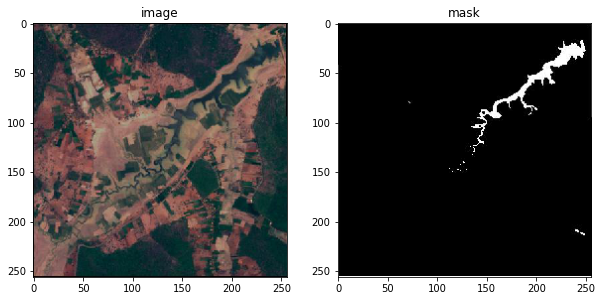

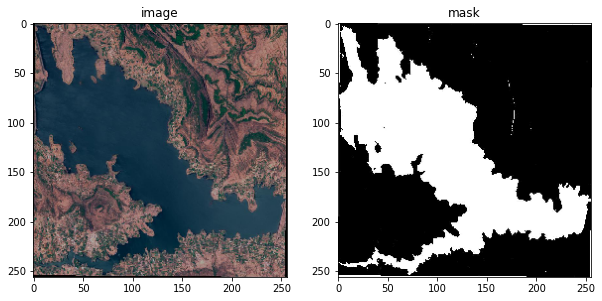

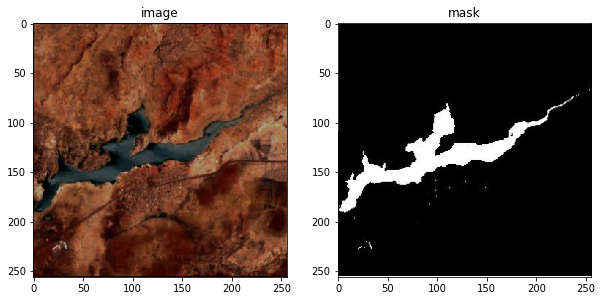

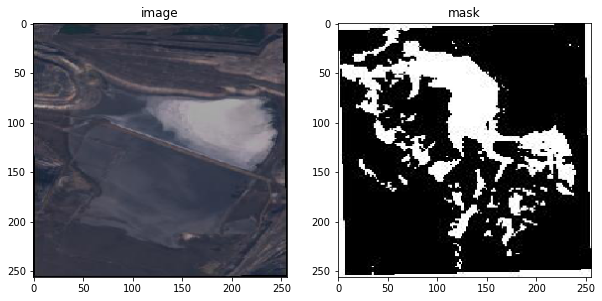

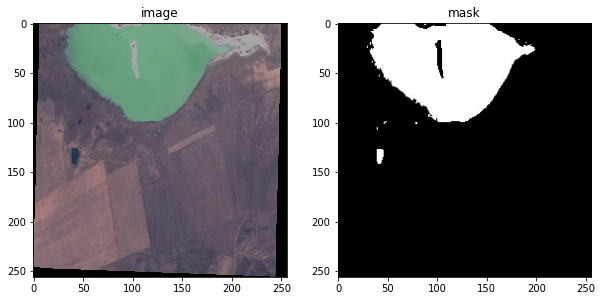

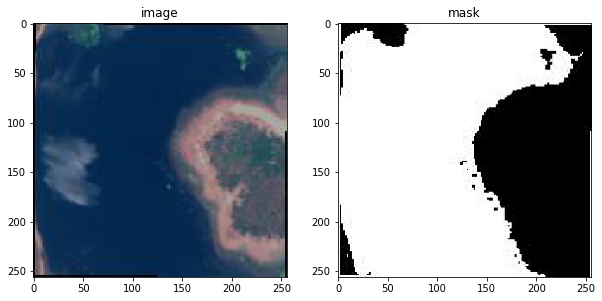

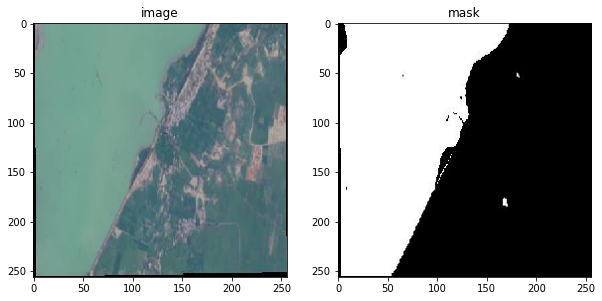

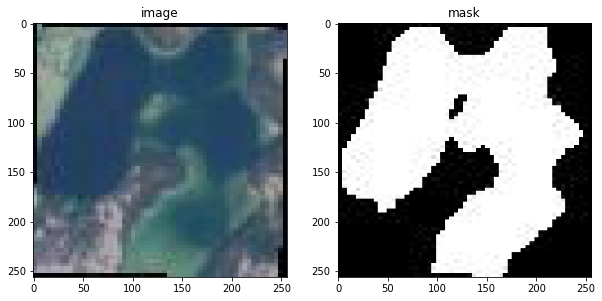

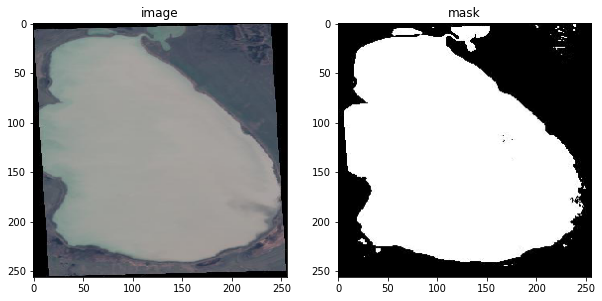

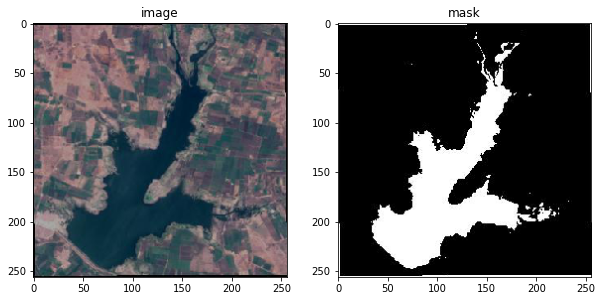

In [ ]:
look_path = train_path #either train_path or val_path
sample_image = random.sample(os.listdir(look_path + "/image/img"),
                             10) #number of samples
for i in sample_image:
    look_dataset(i,look_path = look_path)


# Load model (can be skipped)
here, there's some pre-trained weighs, you can either use those loads as-is or use it as starting point to get faster and better results

nevertheless, you can also ignore this section for now and retrain the weights from the start

---
how to load the weights:


1.   run load cell
2.   don't run `model.fit`, unless you want to overwrite the loaded weights



In [ ]:
# load model
sequential_model = tf.keras.models.load_model(os.path.join(save_path, folder + "_NN1.h5"))
unet_model = tf.keras.models.load_model(os.path.join(save_path, folder + "_NN2.h5"))

In [ ]:
# sequential model visualization
now = datetime.datetime.now()
now = "{}_{}_{}_{}_{}".format(now.year,now.month,now.day,now.hour,now.minute)
plot_model(sequential_model, to_file = save_path + "/sequential_model_" + now + ".png", show_shapes = True)
sequential_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 256, 256, 96)      2688      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 256, 256, 96)      83040     
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 256, 256, 96)      83040     
_________________________________________________________________
layer_normalization (LayerNo (None, 256, 256, 96)      131072    
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 128, 128, 96)      0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 128, 128, 128)     110720    
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 128, 128, 128)     1

In [ ]:
# unet model visualization
now = datetime.datetime.now()
now = "{}_{}_{}_{}_{}".format(now.year,now.month,now.day,now.hour,now.minute)
plot_model(unet_model, to_file = save_path + "/unet_model_" + now + ".png", show_shapes = True)
unet_model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_layer (InputLayer)        [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 24) 672         input_layer[0][0]                
__________________________________________________________________________________________________
activation (Activation)         (None, 256, 256, 24) 0           conv2d[0][0]                     
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 256, 256, 24) 96          activation[0][0]                 
______________________________________________________________________________________________

# NN

## NN version 1

In [ ]:
# preprocess the images and mask; and feed to data generator 
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
# details on https://www.tensorflow.org/api_docs/python/tf/keras/preprocessing/image/ImageDataGenerator
seed = 2
train_image_datagen = ImageDataGenerator(
    rescale = 1./255.,
    rotation_range = 40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range = 0.2,
    zoom_range = 0.2,
    # brightness_range = [1.0, 1.2],
    horizontal_flip = True,
    vertical_flip = True,
    fill_mode = 'nearest') 

train_mask_datagen = ImageDataGenerator(
    rescale = 1./255.,
    rotation_range = 40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range = 0.2,
    zoom_range = 0.2,
    horizontal_flip = True,
    vertical_flip = True,
    fill_mode = 'nearest')  

train_image_generator = train_image_datagen.flow_from_directory(
    train_path + "/image",
    class_mode = None, 
    seed = seed,
    color_mode = "rgb",
    batch_size = 15,
    target_size = (256,256))

train_mask_generator = train_mask_datagen.flow_from_directory(
    train_path + "/mask",
    class_mode = None, 
    seed = seed,
    color_mode = "grayscale",
    batch_size = 15,
    target_size = (256,256))

train_generator = zip(train_image_generator, train_mask_generator)

val_image_datagen = ImageDataGenerator(
    rescale = 1./255.)

val_mask_datagen = ImageDataGenerator(
    rescale = 1./255.) 

val_image_generator = val_image_datagen.flow_from_directory(
    val_path + "/image",
    class_mode = None, 
    seed = seed,
    color_mode = "rgb",
    batch_size = 15,
    target_size = (256,256))

val_mask_generator = val_mask_datagen.flow_from_directory(
    val_path + "/mask",
    class_mode = None, 
    seed = seed,
    color_mode = "grayscale",
    batch_size = 15,
    target_size = (256,256))

val_generator = zip(val_image_generator, val_mask_generator)

Found 1262 images belonging to 1 classes.
Found 1262 images belonging to 1 classes.
Found 315 images belonging to 1 classes.
Found 315 images belonging to 1 classes.


In [ ]:
sequential_model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(96, (3,3), activation = 'relu', padding = "same", input_shape = (256, 256, 3)),
    tf.keras.layers.Conv2D(96, (3,3), activation = 'relu', padding = "same"),
    tf.keras.layers.Conv2D(96, (3,3), activation = 'relu', padding = "same"),
    tf.keras.layers.LayerNormalization(axis = [1,2]),
                                               
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Conv2D(128, (3,3), activation = 'swish', padding = "same"),
    tf.keras.layers.Conv2D(128, (3,3), activation = 'swish', padding = "same"),
    tf.keras.layers.Conv2D(128, (3,3), activation = 'swish', padding = "same"),
    tf.keras.layers.LayerNormalization(axis = [1,2]),
                                               
    tf.keras.layers.UpSampling2D((2,2)),

    tf.keras.layers.Conv2D(64, (3,3), activation = 'swish', padding = "same"),
    tf.keras.layers.Conv2D(64, (3,3), activation = 'swish', padding = "same"),
    tf.keras.layers.Conv2D(64, (3,3), activation = 'swish', padding = "same"),
    tf.keras.layers.LayerNormalization(axis = [1,2]),

    tf.keras.layers.Conv2D(1, (3,3), activation = 'sigmoid', padding = "same")  
    ])

sequential_model.compile(
    optimizer = "Adam",
    loss = 'binary_crossentropy',
    metrics = ['MSE', "accuracy"])


In [ ]:
callback = tf.keras.callbacks.EarlyStopping(monitor = "val_loss", patience = 20, restore_best_weights = True)
results = sequential_model.fit(
    train_generator,
    epochs = 50,
    steps_per_epoch = 20, 
    validation_data = val_generator,
    validation_steps = 20,
    callbacks = [callback]
)

Epoch 1/50
20/20 [==============================] - 14s 632ms/step - loss: 0.5616 - MSE: 0.1635 - accuracy: 0.7434 - val_loss: 0.4357 - val_MSE: 0.1336 - val_accuracy: 0.8377
Epoch 2/50
20/20 [==============================] - 12s 614ms/step - loss: 0.4834 - MSE: 0.1365 - accuracy: 0.7930 - val_loss: 0.3856 - val_MSE: 0.1106 - val_accuracy: 0.8748
Epoch 3/50
20/20 [==============================] - 12s 620ms/step - loss: 0.4524 - MSE: 0.1252 - accuracy: 0.8046 - val_loss: 0.3555 - val_MSE: 0.0982 - val_accuracy: 0.8819
Epoch 4/50
20/20 [==============================] - 12s 614ms/step - loss: 0.4252 - MSE: 0.1098 - accuracy: 0.8178 - val_loss: 0.3353 - val_MSE: 0.0941 - val_accuracy: 0.8902
Epoch 5/50
20/20 [==============================] - 12s 610ms/step - loss: 0.3866 - MSE: 0.0969 - accuracy: 0.8396 - val_loss: 0.3276 - val_MSE: 0.0916 - val_accuracy: 0.8884
Epoch 6/50
20/20 [==============================] - 12s 620ms/step - loss: 0.4040 - MSE: 0.1036 - accuracy: 0.8249 - val_loss

## NN version2

In [ ]:
train_image_datagen = ImageDataGenerator(
    rescale = 1./255.,
    rotation_range = 40,
    width_shift_range = 0.2,
    height_shift_range = 0.2,
    shear_range = 0.2,
    zoom_range = 0.2,
    # brightness_range = [0.8, 1.0],
    # brightness_range = [1.0, 1.2],
    horizontal_flip = True,
    vertical_flip = True,
    fill_mode = 'nearest')

train_mask_datagen = ImageDataGenerator(
    rescale = 1./255.,
    rotation_range = 40,
    width_shift_range = 0.2,
    height_shift_range = 0.2,
    shear_range = 0.2,
    zoom_range = 0.2,
    horizontal_flip = True,
    vertical_flip = True,
    fill_mode = 'nearest')

val_image_datagen = ImageDataGenerator(
        rescale = 1./255.)

val_mask_datagen = ImageDataGenerator(
        rescale = 1./255.)

def generator(generatorX, generatorY, X, Y):
    seed = 2 

    genX = generatorX.flow_from_directory(
        X,
        class_mode = None, 
        seed = seed,
        batch_size = 15,
        target_size = (256,256))
    
    genY = generatorY.flow_from_directory(
        Y,
        class_mode = None, 
        seed = seed,
        batch_size = 15,
        color_mode = "grayscale",
        target_size = (256,256))

    while True:
        Xi = genX.next()
        Yi = genY.next()
        yield Xi, Yi

In [ ]:
# unet with 3 residual layers [x1,x2,x3]
# you could put the blocks inside a function to reuse code, but I choose a more straighfoward visualization
def unet_base(input_shape):
    base_unit = 24
    concat_unit = 32
    activation = "relu"
    input = tf.keras.layers.Input(shape = input_shape, name = "input_layer")

    #conv block 1
    x = tf.keras.layers.Conv2D( base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(input)
    x = tf.keras.layers.Activation(activation)(x)

    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x1 = tf.keras.layers.Activation(activation, name = "residual_1")(x) #Residual layer 1, shape = input_shape

    x = tf.keras.layers.BatchNormalization( )(x1) 
    x = tf.keras.layers.Conv2D( base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal", 
                               strides = (2, 2))(x) #shape = input_shape / 2
    x = tf.keras.layers.Activation(activation)(x)
    x = tf.keras.layers.Dropout(0.1)(x)

    #conv block 2
    x = tf.keras.layers.BatchNormalization( )(x) 
    x = tf.keras.layers.Conv2D( 2 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x)

    x = tf.keras.layers.BatchNormalization( )(x) 
    x = tf.keras.layers.Conv2D( 2 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x2 = tf.keras.layers.Activation(activation, name = "residual_2")(x) #Residual layer 2, shape = input_shape / 2

    x = tf.keras.layers.BatchNormalization( )(x2) 
    x = tf.keras.layers.Conv2D( 2 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal", 
                               strides = (2, 2))(x) #shape = input_shape / 4
    x = tf.keras.layers.Activation(activation)(x)
    x = tf.keras.layers.Dropout(0.1)(x)
    
    #conv block 3
    x = tf.keras.layers.BatchNormalization( )(x) 
    x = tf.keras.layers.Conv2D( 4 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x)

    x = tf.keras.layers.BatchNormalization( )(x) 
    x = tf.keras.layers.Conv2D( 4 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x3 = tf.keras.layers.Activation(activation, name = "residual_3")(x) #Residual layer 3, shape = input_shape / 4

    x = tf.keras.layers.BatchNormalization( )(x3) 
    x = tf.keras.layers.Conv2D( 4 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal", 
                               strides = (2, 2))(x) #shape = input_shape / 8
    x = tf.keras.layers.Activation(activation)(x)
    x = tf.keras.layers.Dropout(0.1)(x)
    
    #conv block 4 (bottom)
    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( 8 * base_unit, (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x)

    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( 8 * base_unit, (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x)
    x = tf.keras.layers.Dropout(0.1)(x)

    #conv up 1
    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.UpSampling2D((2,2))(x)
    x = tf.keras.layers.Conv2D( 4 * base_unit, kernel_size = (3,3), padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 

    x = tf.keras.layers.Concatenate()([x,x3]) #concatenate residual layer 3
    
    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( 4 * concat_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 

    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( 4 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 
    x = tf.keras.layers.Dropout(0.1)(x)
    
    #conv up 2
    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.UpSampling2D((2,2))(x)
    x = tf.keras.layers.Conv2D( 2 * base_unit, kernel_size = (3,3), padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 


    x = tf.keras.layers.Concatenate()([x,x2]) #concatenate residual layer 2
    
    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( 2 * concat_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 

    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( 2 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 
    x = tf.keras.layers.Dropout(0.1)(x)

    #conv up 3
    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.UpSampling2D((2,2))(x)
    x = tf.keras.layers.Conv2D( 1 * base_unit, kernel_size = (3,3), padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 

    x = tf.keras.layers.Concatenate()([x,x1]) #concatenate residual layer 1
    
    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( 1 * concat_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 

    x = tf.keras.layers.BatchNormalization( )(x)
    x = tf.keras.layers.Conv2D( 1 * base_unit , (3,3), activation = None, padding = "same", kernel_initializer = "he_normal")(x)
    x = tf.keras.layers.Activation(activation)(x) 
    x = tf.keras.layers.Dropout(0.1)(x)

    #output
    y = tf.keras.layers.Conv2D(1, (1,1), activation = "sigmoid", name = "output_layer")(x)

    model = tf.keras.models.Model(
        inputs = input,
        outputs = y)
    
    return model

unet_model = unet_base(input_shape = (256, 256, 3))

unet_model.compile(optimizer = tf.keras.optimizers.Adam(tf.keras.optimizers.schedules.ExponentialDecay(
        initial_learning_rate = 0.00005, decay_steps = 100, decay_rate = 0.80)), 
              loss = {"output_layer" : "binary_crossentropy"},
              metrics = {"output_layer" : ["accuracy"]}
              )
unet_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_layer (InputLayer)        [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d_20 (Conv2D)              (None, 256, 256, 24) 672         input_layer[0][0]                
__________________________________________________________________________________________________
activation_17 (Activation)      (None, 256, 256, 24) 0           conv2d_20[0][0]                  
__________________________________________________________________________________________________
batch_normalization_19 (BatchNo (None, 256, 256, 24) 96          activation_17[0][0]              
____________________________________________________________________________________________

In [ ]:
# if you are not too patient, you can lower the "patience"               ↓ HERE  ↓
callback = tf.keras.callbacks.EarlyStopping(monitor = "val_accuracy", patience = 20, restore_best_weights = True)
history = unet_model.fit(
    generator(train_image_datagen, train_mask_datagen, train_path + "/image", train_path + "/mask"),
    epochs = 50,
    steps_per_epoch = 20,
    verbose = 1,
    validation_data = generator(val_image_datagen, val_mask_datagen, val_path + "/image", val_path + "/mask"),
    validation_steps = 20,
    callbacks = [callback]
    )


Found 1262 images belonging to 1 classes.
Found 1262 images belonging to 1 classes.
Epoch 1/50
20/20 [==============================] - ETA: 0s - loss: 0.6285 - accuracy: 0.6237Found 315 images belonging to 1 classes.
Found 315 images belonging to 1 classes.
20/20 [==============================] - 20s 1s/step - loss: 0.6285 - accuracy: 0.6237 - val_loss: 0.5279 - val_accuracy: 0.7536
Epoch 2/50
20/20 [==============================] - 20s 987ms/step - loss: 0.6213 - accuracy: 0.6359 - val_loss: 0.5241 - val_accuracy: 0.7580
Epoch 3/50
20/20 [==============================] - 19s 985ms/step - loss: 0.6321 - accuracy: 0.6234 - val_loss: 0.5294 - val_accuracy: 0.7557
Epoch 4/50
20/20 [==============================] - 19s 985ms/step - loss: 0.6282 - accuracy: 0.6261 - val_loss: 0.5300 - val_accuracy: 0.7545
Epoch 5/50
20/20 [==============================] - 19s 967ms/step - loss: 0.6181 - accuracy: 0.6402 - val_loss: 0.5399 - val_accuracy: 0.7496
Epoch 6/50
20/20 [======================

# predict results

In [ ]:
def predict(path, threshold, models):
    for i, model in enumerate(models, start = 1):
        if model == "a":
            pass
        else:
            if i == 1:
                i = "sequential"
            if i == 2:
                i = "unet"
            input = tf.keras.preprocessing.image.load_img(path, target_size = (256,256))
            fig = plt.figure(figsize = (20, 20))
            input_arr = tf.keras.preprocessing.image.img_to_array(input)
            input_arr = np.array(input_arr) 
            input_arr = input_arr/255.0

            fig.add_subplot(1, 4, 1)
            plt.setp(plt.title("input_model_" + str(i)), color = "white")         
            plt.imshow(input_arr)

            fig.add_subplot(1, 4, 2)
            input_predict = np.reshape(input_arr,(1,256,256,3))
            imagem = model.predict(input_predict)
            imagem = imagem * 255.0
            imagem = imagem.astype(int)
            imagem = np.reshape(imagem,(256,256))
            plt.setp(plt.title("output_model_" + str(i)), color = "white")         
            plt.imshow(imagem)

            fig.add_subplot(1, 4, 3)
            mask = imagem < threshold
            plt.setp(plt.title("mask_overlay, pixel_value: " + str(threshold)), color = "white")         
            plt.imshow(input_arr)
            plt.imshow(np.ma.masked_where(mask,a = imagem),alpha=0.45,cmap='PuRd')

            fig.add_subplot(1, 4, 4)
            binary = np.where(mask < 0.5, 1, 0)
            binary = np.stack([binary,binary,binary],axis=2)

            result = input_arr * binary
            plt.setp(plt.title("binary_crop"), color = "white")         
            plt.imshow(result) 

            plt.show()


In [ ]:
def upload(threshold, models):
    uploaded = files.upload()
    for image in uploaded.keys():
        path = '/content/' + image
        predict(path = path,
                threshold = threshold,
                models = models)

# See predicts

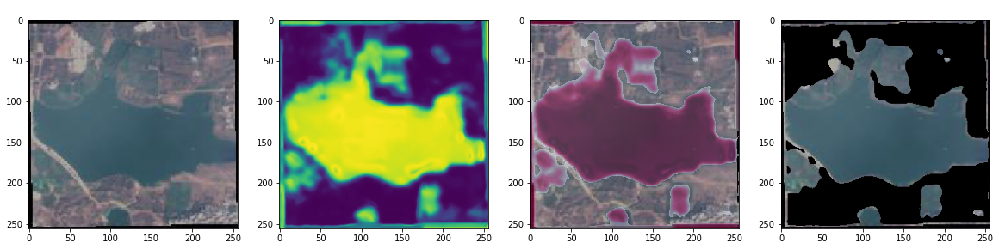

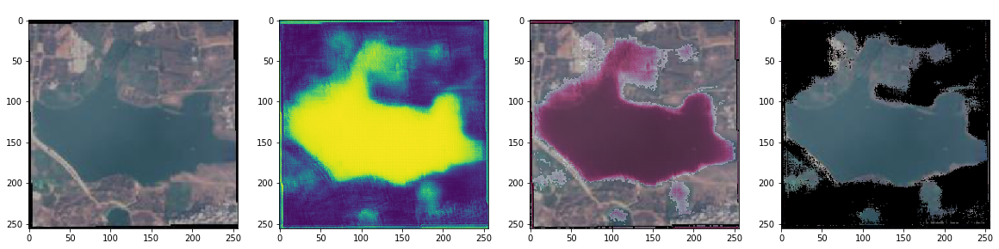

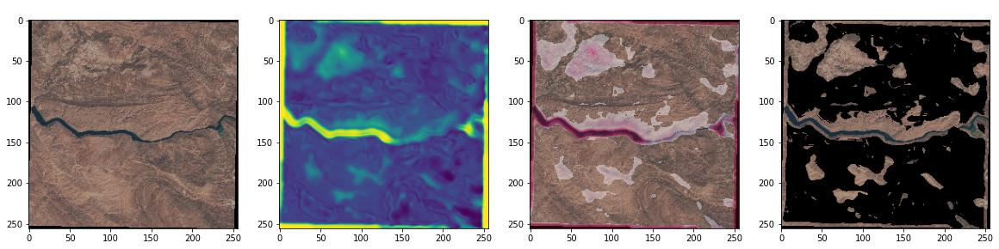

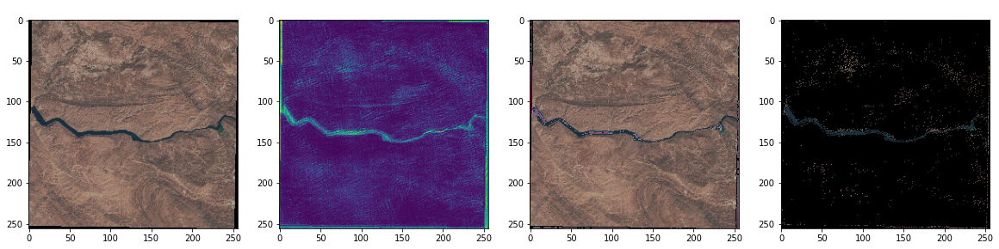

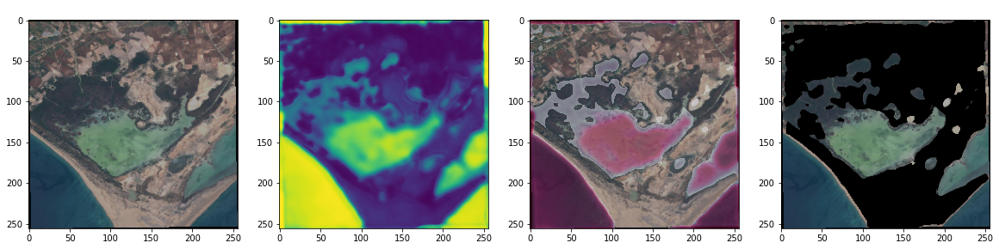

...

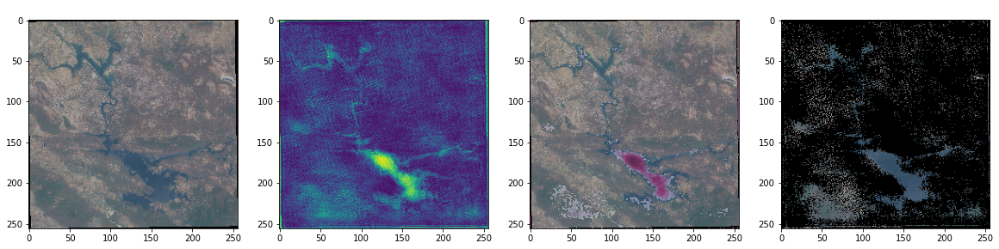

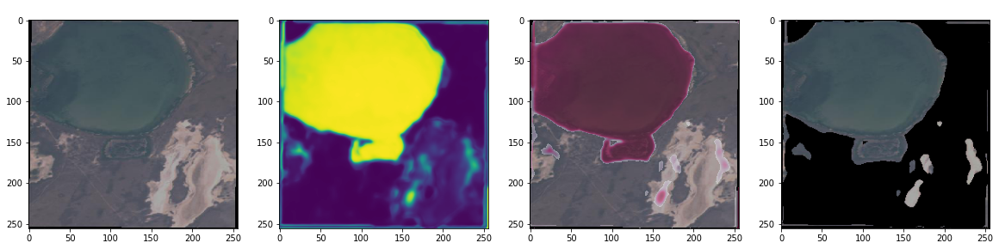

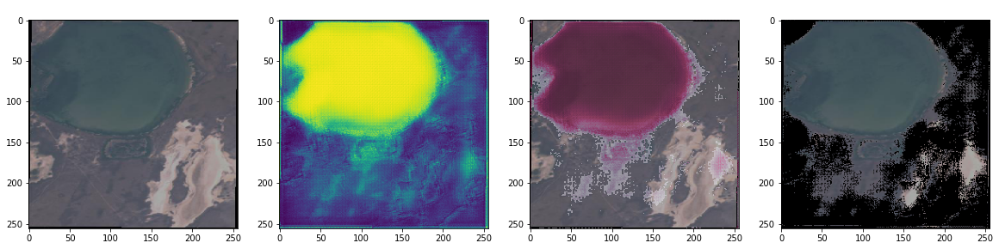

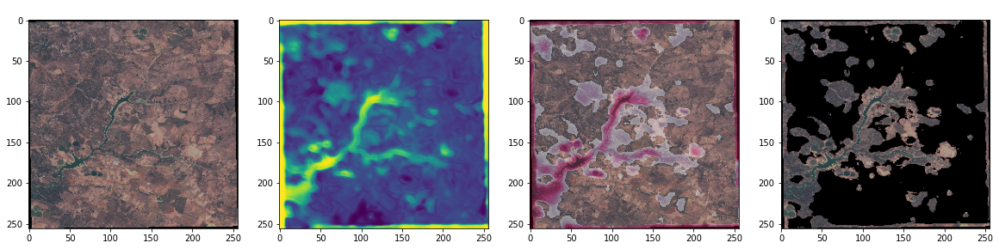

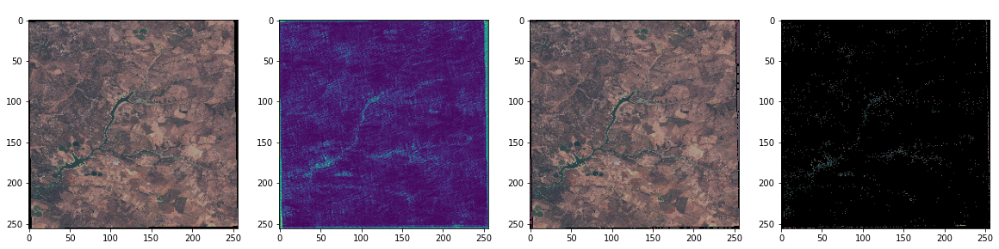

In [ ]:
val_images_path = val_path + "/image/img"
imagems = random.sample(os.listdir(val_images_path), 10) # set the number of images
for imagem in imagems:
    predict(os.path.join(
        val_images_path,imagem),
        threshold = 70, # mask overlay threshold
        models = [sequential_model, unet_model]) # compare the models
        

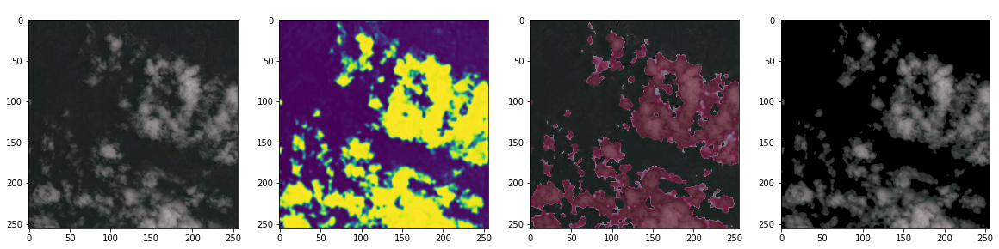

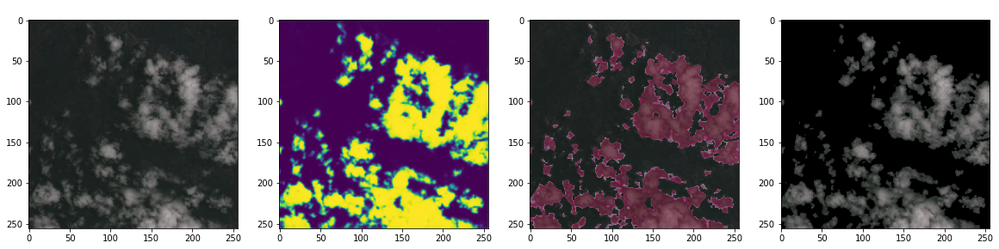

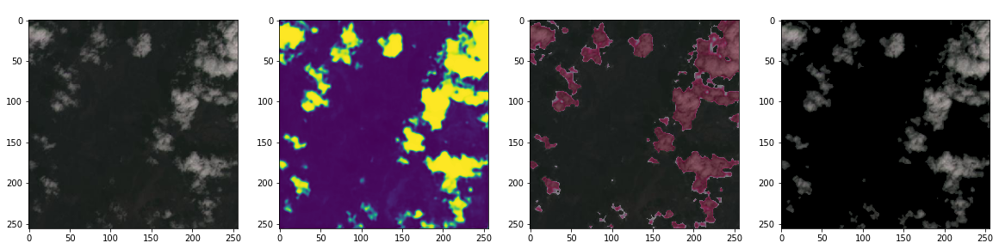

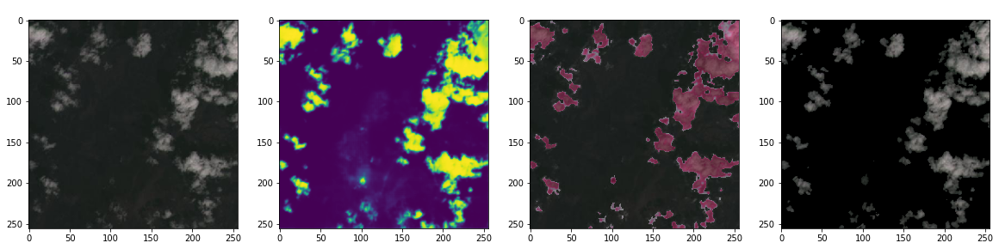

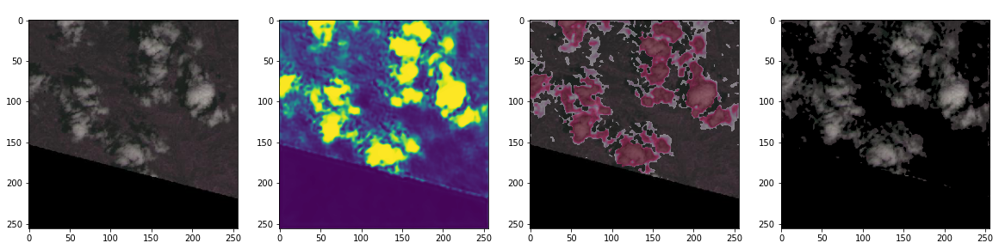

...

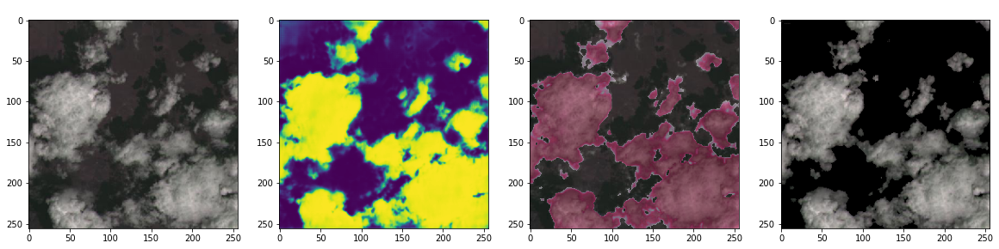

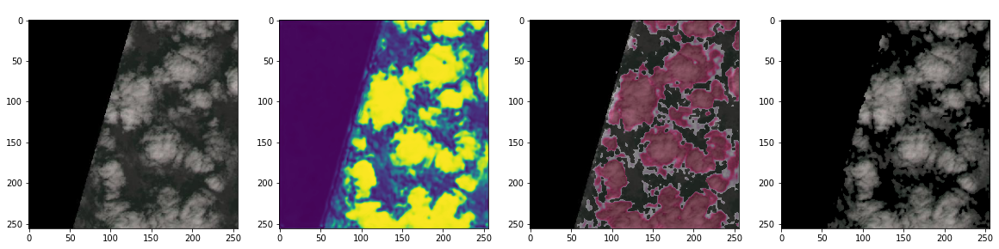

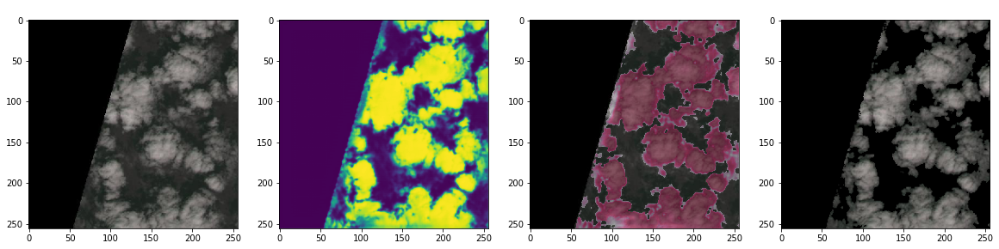

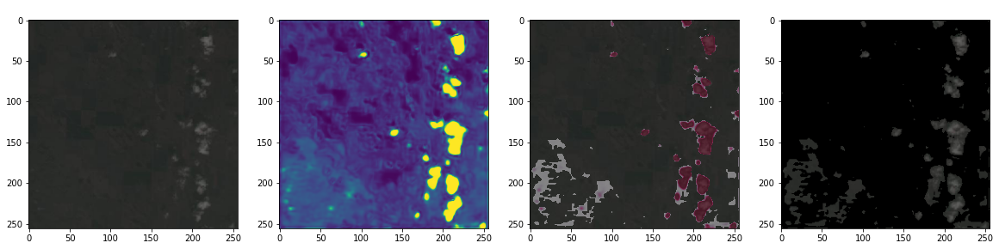

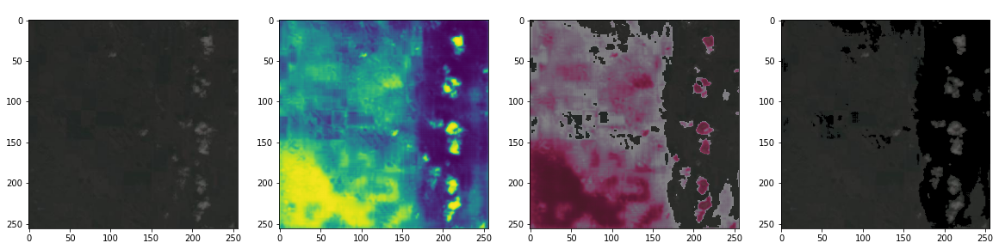

In [ ]:
val_images_path = val_path + "/image/img"
imagems = random.sample(os.listdir(val_images_path), 10) # set the number of images
for imagem in imagems:
    predict(os.path.join(
        val_images_path,imagem),
        threshold = 70, # mask overlay threshold
        models = [sequential_model, unet_model]) # compare the models
        

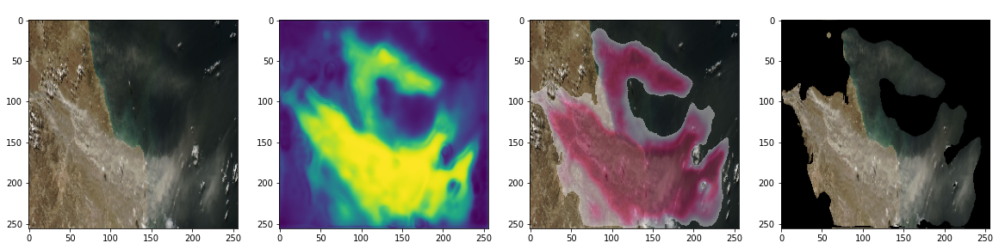

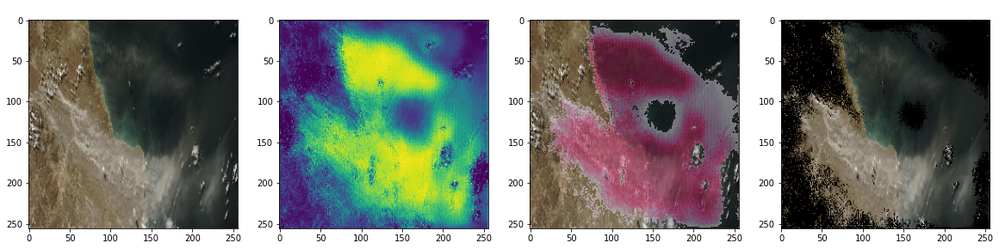

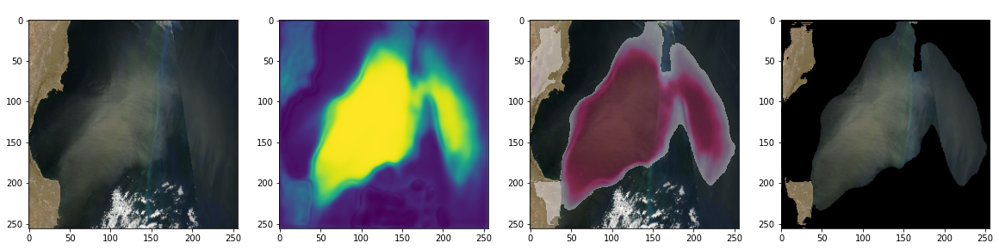

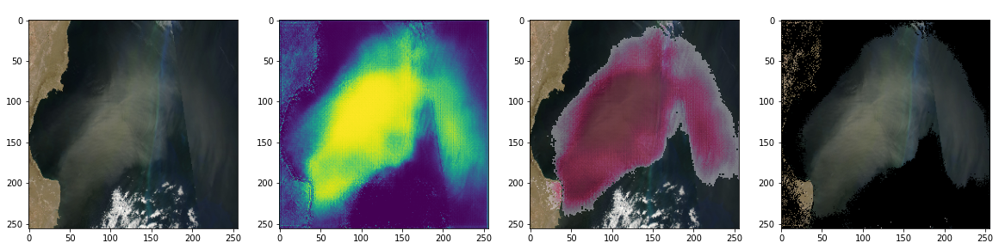

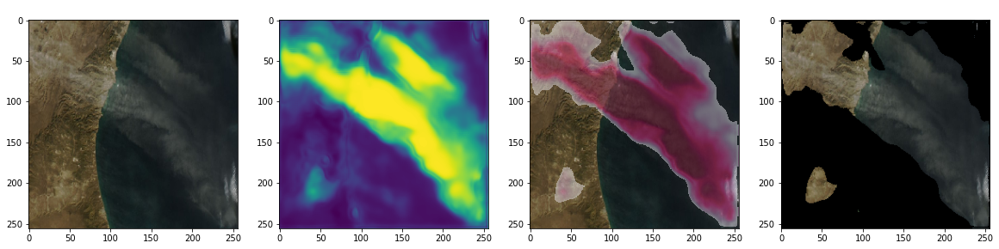

...

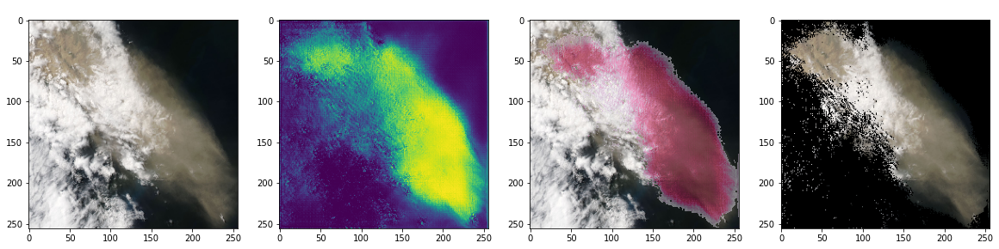

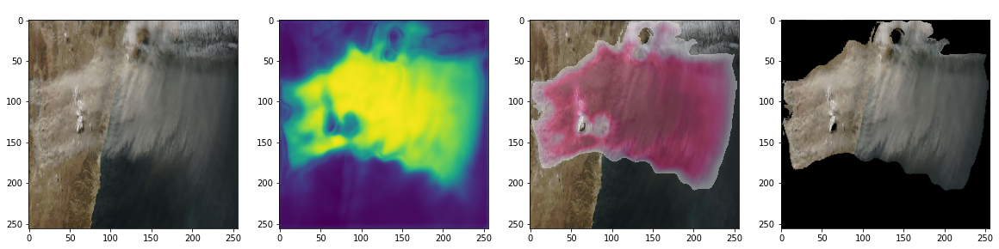

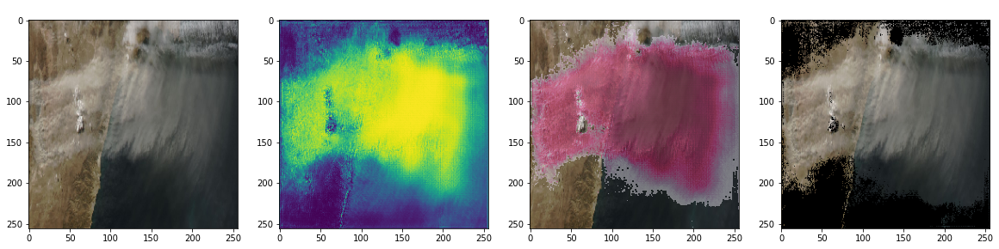

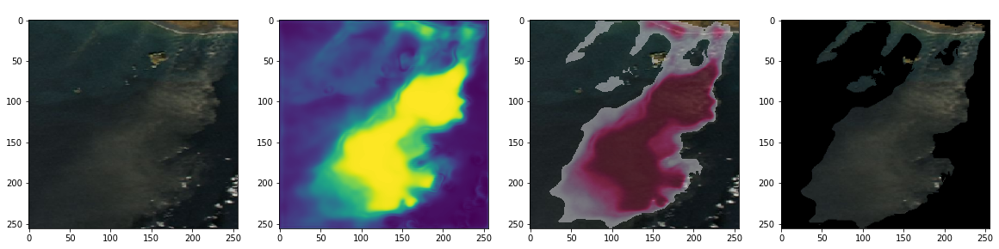

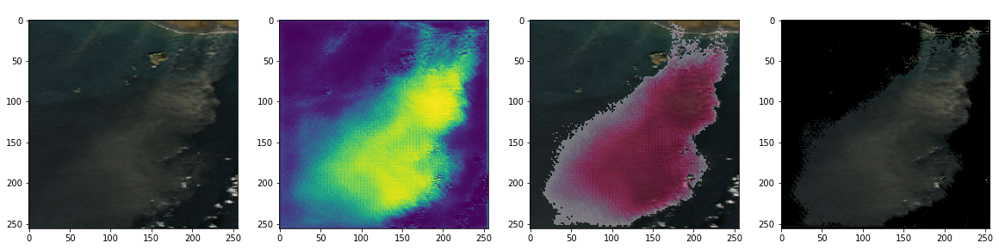

In [ ]:
val_images_path = val_path + "/image/img"
imagems = random.sample(os.listdir(val_images_path), 10) # set the number of images
for imagem in imagems:
    predict(os.path.join(
        val_images_path,imagem),
        threshold = 70, # mask overlay threshold
        models = [sequential_model, unet_model]) # compare the models
        

In [ ]:
# #run this cell to upload your own images
# upload(threshold = 100,
#        models = [sequential_model, unet_model]) # compare the models)

In [ ]:
# download test data
id = "1pm7BB0JnqDUJU8qSny6mUvku15725Xv4"
test_folder = "test_data"

GoogleDriveDownloader.download_file_from_google_drive(file_id = id,
                                                      dest_path = os.path.join("/content/", test_folder + ".zip"),
                                                      unzip = True)


Unzipping...Done.


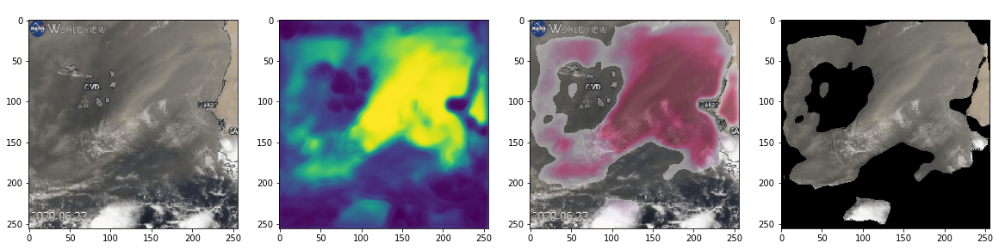

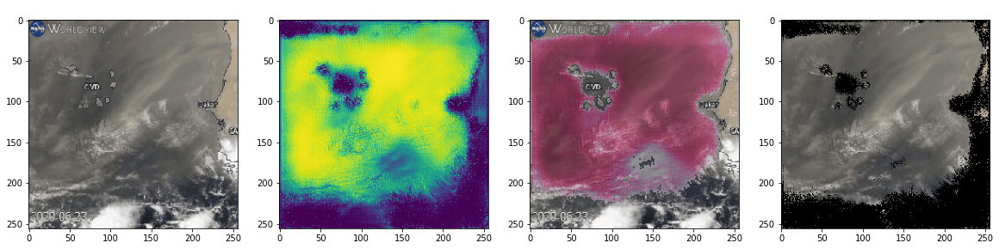

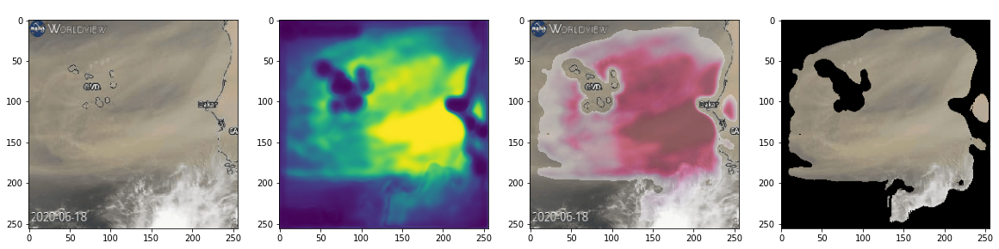

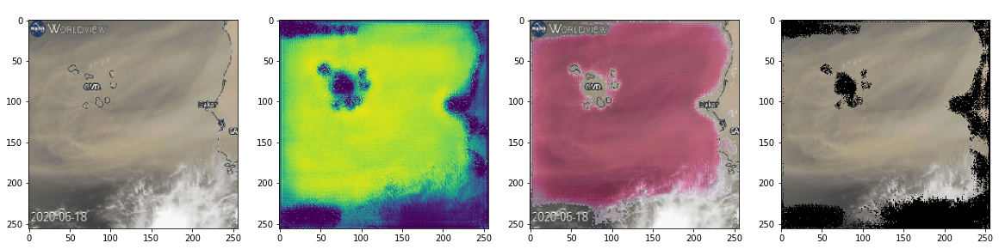

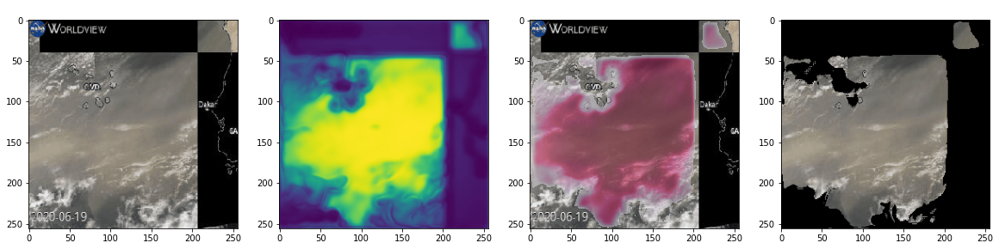

...

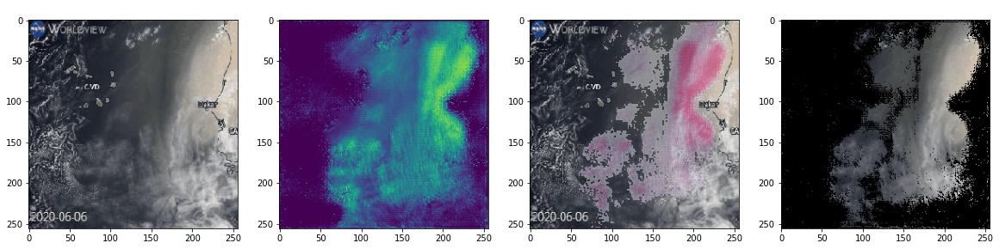

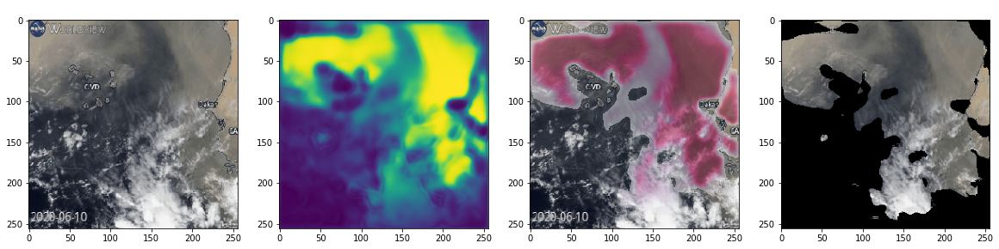

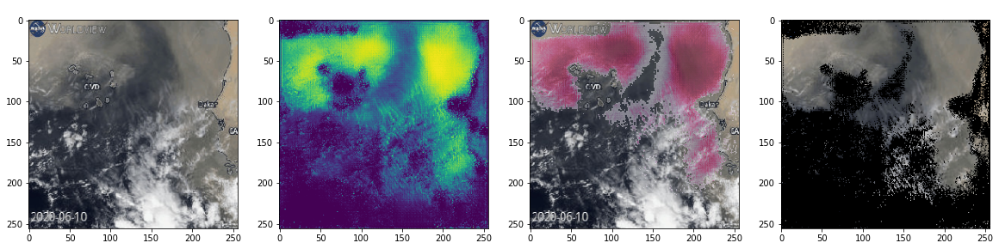

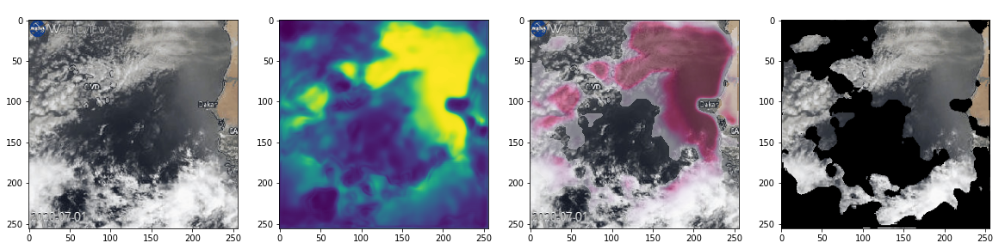

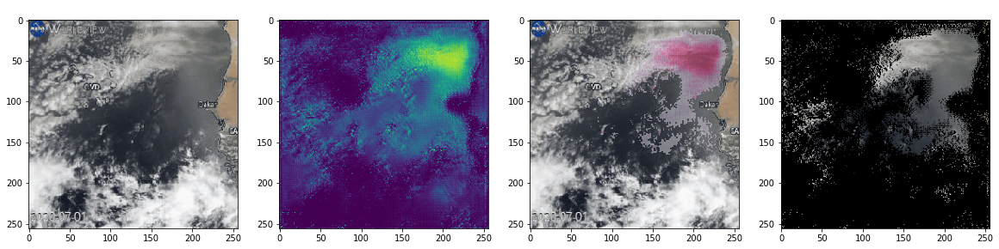

In [ ]:
test_path = "/content/test_data"
test_list = os.listdir(test_path)
for image in test_list:
    predict(os.path.join(
        test_path,image),
        threshold = 70, # mask overlay threshold
        models = [sequential_model, unet_model]) # compare the models

# Save model
saves **are not preserved** *through sessions* 

if you want to keep it, either run the **download** cell or save it in **your drive**

In [ ]:
# save the sequential model
now = datetime.datetime.now()
now = "{}_{}_{}_{}_{}".format(now.year,now.month,now.day,now.hour,now.minute)
sequential_model.save(save_path + "/sequential_model_" + now + ".h5")

In [ ]:
# save the unet model
now = datetime.datetime.now()
now = "{}_{}_{}_{}_{}".format(now.year,now.month,now.day,now.hour,now.minute)
unet_model.save(save_path + "/unet_model_" + now + ".h5")

In [ ]:
# select save data
saves = os.listdir(save_path)
save = ipywidgets.Dropdown(options = saves)
save

Dropdown(options=('cloud_NN2.h5', 'cloud_NN1.h5', 'sequential_model_2021_2_4_19_8.h5'), value='cloud_NN2.h5')

In [ ]:
#download
files.download(os.path.join(save_path, save.value))

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# model visualization, datatime from the last saved model
plot_model(model, to_file = save_path + "/model_" + now + ".png", show_shapes = True)

In [ ]:
# load model from save
if "unet_model" in save.value:
    unet_model = tf.keras.models.load_model(os.path.join(save_path, save.value)
if "sequential_model" in save.value:
    sequential_model = tf.keras.models.load_model(os.path.join(save_path, save.value)